# Crime Data Visualization
We will be looking at crime data from Chicago and Los Angeles obtained from the cities respective data portals.

In [1]:
import numpy as np
import pandas as pd
import matplotlib.pyplot as plt
import plotly.express as px
import folium as fm
import geopandas as gpd
import altair as alt
import pyproj
%matplotlib notebook

In [2]:
import warnings
warnings.filterwarnings('ignore')

## Chicago Dataset

In [3]:
df_chi = pd.read_csv('CHI.csv')

In [4]:
df_chi.head()

,ID,Case Number,Date,Block,IUCR,Primary Type,Description,Location Description,Arrest,Domestic,...,Ward,Community Area,FBI Code,X Coordinate,Y Coordinate,Year,Updated On,Latitude,Longitude,Location
0,11037294,JA371270,2015-03-18 12:00:00,0000X W WACKER DR,1153,DECEPTIVE PRACTICE,FINANCIAL IDENTITY THEFT OVER $ 300,BANK,False,False,...,42.0,32.0,11,NaN,NaN,2015,2017-08-01 15:52:26,NaN,NaN,NaN
1,11646293,JC213749,2018-12-20 15:00:00,023XX N LOCKWOOD AVE,1154,DECEPTIVE PRACTICE,FINANCIAL IDENTITY THEFT $300 AND UNDER,APARTMENT,False,False,...,36.0,19.0,11,NaN,NaN,2018,2019-04-06 16:04:43,NaN,NaN,NaN
2,11645836,JC212333,2016-05-01 00:25:00,055XX S ROCKWELL ST,1153,DECEPTIVE PRACTICE,FINANCIAL IDENTITY THEFT OVER $ 300,NaN,False,False,...,15.0,63.0,11,NaN,NaN,2016,2019-04-06 16:04:43,NaN,NaN,NaN
3,11645959,JC211511,2018-12-20 16:00:00,045XX N ALBANY AVE,2820,OTHER OFFENSE,TELEPHONE THREAT,RESIDENCE,False,False,...,33.0,14.0,08A,NaN,NaN,2018,2019-04-06 16:04:43,NaN,NaN,NaN
4,11645601,JC212935,2014-06-01 00:01:00,087XX S SANGAMON ST,1153,DECEPTIVE PRACTICE,FINANCIAL IDENTITY THEFT OVER $ 300,RESIDENCE,False,False,...,21.0,71.0,11,NaN,NaN,2014,2019-04-06 16:04:43,NaN,NaN,NaN


In [5]:
# get size of dataset
df_chi.shape

(2975937, 22)

In [6]:
# get column names
df_chi.columns

Index(['ID', 'Case Number', 'Date', 'Block', 'IUCR', 'Primary Type',
       'Description', 'Location Description', 'Arrest', 'Domestic', 'Beat',
       'District', 'Ward', 'Community Area', 'FBI Code', 'X Coordinate',
       'Y Coordinate', 'Year', 'Updated On', 'Latitude', 'Longitude',
       'Location'],
      dtype='object')

In [7]:
df_chi.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 2975937 entries, 0 to 2975936
Data columns (total 22 columns):
 #   Column                Dtype  
---  ------                -----  
 0   ID                    int64  
 1   Case Number           object 
 2   Date                  object 
 3   Block                 object 
 4   IUCR                  object 
 5   Primary Type          object 
 6   Description           object 
 7   Location Description  object 
 8   Arrest                bool   
 9   Domestic              bool   
 10  Beat                  int64  
 11  District              float64
 12  Ward                  float64
 13  Community Area        float64
 14  FBI Code              object 
 15  X Coordinate          float64
 16  Y Coordinate          float64
 17  Year                  int64  
 18  Updated On            object 
 19  Latitude              float64
 20  Longitude             float64
 21  Location              object 
dtypes: bool(2), float64(7), int64(3), object(1

In [8]:
# converting Date to datetime type
df_chi['Date'] = pd.to_datetime(df_chi['Date'], format='%Y-%m-%d %H:%M:%S')

In [9]:
# converting Updated On to datetime type
df_chi['Updated On'] = pd.to_datetime(df_chi['Updated On'], format='%Y-%m-%d %H:%M:%S')

In [10]:
# converting necessary columns to object type
df_chi[['Arrest', 'Domestic', 'Beat']] = df_chi[['Arrest', 'Domestic', 'Beat']].astype('object')

In [11]:
df_chi.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 2975937 entries, 0 to 2975936
Data columns (total 22 columns):
 #   Column                Dtype         
---  ------                -----         
 0   ID                    int64         
 1   Case Number           object        
 2   Date                  datetime64[ns]
 3   Block                 object        
 4   IUCR                  object        
 5   Primary Type          object        
 6   Description           object        
 7   Location Description  object        
 8   Arrest                object        
 9   Domestic              object        
 10  Beat                  object        
 11  District              float64       
 12  Ward                  float64       
 13  Community Area        float64       
 14  FBI Code              object        
 15  X Coordinate          float64       
 16  Y Coordinate          float64       
 17  Year                  int64         
 18  Updated On            datetime64[ns]
 19  

### Data Wrangling

In [12]:
# missing data
df_chi.isnull().sum()

ID                          0
Case Number                 0
Date                        0
Block                       0
IUCR                        0
Primary Type                0
Description                 0
Location Description     7112
Arrest                      0
Domestic                    0
Beat                        0
District                    1
Ward                       66
Community Area            396
FBI Code                    0
X Coordinate            26628
Y Coordinate            26628
Year                        0
Updated On                  0
Latitude                26628
Longitude               26628
Location                26628
dtype: int64

In [13]:
# dropping X Coordinate and Y Coordinate as they are the same as Longitude and Latitude
df_chi = df_chi.drop(columns = ['X Coordinate', 'Y Coordinate'])

In [14]:
# dropping all rows with missing values
df_chi = df_chi.dropna()

In [15]:
# reseting indexes
df_chi.reset_index(drop = True, inplace = True)

In [16]:
df_chi.shape

(2944776, 20)

In [17]:
df_chi.isnull().sum()

ID                      0
Case Number             0
Date                    0
Block                   0
IUCR                    0
Primary Type            0
Description             0
Location Description    0
Arrest                  0
Domestic                0
Beat                    0
District                0
Ward                    0
Community Area          0
FBI Code                0
Year                    0
Updated On              0
Latitude                0
Longitude               0
Location                0
dtype: int64

In [18]:
# creating new column matching community number to community name using:
# https://www.chicago.gov/content/dam/city/depts/doit/general/GIS/Chicago_Maps/Citywide_Maps/Community_Areas_W_Numbers.pdf
# https://chirecoveryplan.com/ adds up when looking at econ hardship levels

community_mapping = {
    1: 'Rogers Park',
    2: 'West Ridge',
    3: 'Uptown',
    4: 'Lincoln Square',
    5: 'North Center',
    6: 'Lake View',
    7: 'Lincoln Park',
    8: 'Near North Side',
    9: 'Edison Park',
    10: 'Norwood Park',
    11: 'Jefferson Park',
    12: 'Forest Glen',
    13: 'North Park',
    14: 'Albany Park',
    15: 'Portage Park',
    16: 'Irving Park',
    17: 'Dunning',
    18: 'Montclare',
    19: 'Belmont Cragin',
    20: 'Hermosa',
    21: 'Avondale',
    22: 'Logan Square',
    23: 'Humboldt Park',
    24: 'West Town',
    25: 'Austin',
    26: 'West Garfield Park',
    27: 'East Garfield Park',
    28: 'Near West Side',
    29: 'North Lawndale',
    30: 'South Lawndale',
    31: 'Lower West Side',
    32: 'Loop',
    33: 'Near South Side',
    34: 'Armour Square',
    35: 'Douglas',
    36: 'Oakland',
    37: 'Fuller Park',
    38: 'Grand Boulevard',
    39: 'Kenwood',
    40: 'Washington Park',
    41: 'Hyde Park',
    42: 'Woodlawn',
    43: 'South Shore',
    44: 'Chatham',
    45: 'Avalon',
    46: 'South Chicago',
    47: 'Burnside',
    48: 'Calumet Heights',
    49: 'Roseland',
    50: 'Pullman',
    51: 'South Deering',
    52: 'East Side',
    53: 'West Pullman',
    54: 'Riverdale',
    55: 'Hegewisch',
    56: 'Garfield Ridge',
    57: 'Archer Heights',
    58: 'Brighton Park',
    59: 'Mckinley Park',
    60: 'Bridgeport',
    61: 'New City',
    62: 'West Elsdon',
    63: 'Gage Park',
    64: 'Clearing',
    65: 'West Lawn',
    66: 'Chicago Lawn',
    67: 'West Englewood',
    68: 'Englewood',
    69: 'Greater Grand Crossing',
    70: 'Ashburn',
    71: 'Auburn Gresham',
    72: 'Beverly',
    73: 'Washington Heights',
    74: 'Mount Greenwood',
    75: 'Morgan Park',
    76: 'Ohare',
    77: 'Edgewater'
}

# community name column using district numbers
df_chi['Community Name'] = df_chi['Community Area'].map(community_mapping)

In [19]:
df_chi.head()

,ID,Case Number,Date,Block,IUCR,Primary Type,Description,Location Description,Arrest,Domestic,...,District,Ward,Community Area,FBI Code,Year,Updated On,Latitude,Longitude,Location,Community Name
0,12098557,JD288415,2019-02-01 00:01:00,025XX W 50TH ST,0460,BATTERY,SIMPLE,RESIDENCE,False,True,...,9.0,14.0,63.0,08B,2019,2020-07-09 15:44:39,41.802925,-87.687367,"(41.802924631, -87.687367104)",Gage Park
1,12082526,JD269406,2019-09-24 12:00:00,050XX N KENMORE AVE,1153,DECEPTIVE PRACTICE,FINANCIAL IDENTITY THEFT OVER $ 300,RESIDENCE,False,False,...,20.0,48.0,3.0,11,2019,2020-06-24 15:40:28,41.974346,-87.656361,"(41.974346203, -87.656361214)",Uptown
2,11859264,JC470909,2019-10-13 06:40:00,012XX S KARLOV AVE,1310,CRIMINAL DAMAGE,TO PROPERTY,APARTMENT,False,True,...,10.0,24.0,29.0,14,2019,2019-10-20 19:09:58,41.865214,-87.727590,"(41.865213688, -87.727590376)",North Lawndale
3,11662417,JC232642,2019-04-21 12:30:00,009XX E 80TH ST,031A,ROBBERY,ARMED - HANDGUN,RESIDENCE,False,False,...,6.0,8.0,44.0,03,2019,2023-09-14 15:41:59,41.749500,-87.601157,"(41.749500329, -87.6011574)",Chatham
4,12990873,JG161829,2019-08-17 13:14:00,008XX N KARLOV AVE,1751,OFFENSE INVOLVING CHILDREN,CRIMINAL SEXUAL ABUSE BY FAMILY MEMBER,RESIDENCE,True,True,...,11.0,37.0,23.0,17,2019,2023-09-14 15:41:59,41.896215,-87.728572,"(41.89621515, -87.728572048)",Humboldt Park


In [20]:
# check for correct format
df_chi.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 2944776 entries, 0 to 2944775
Data columns (total 21 columns):
 #   Column                Dtype         
---  ------                -----         
 0   ID                    int64         
 1   Case Number           object        
 2   Date                  datetime64[ns]
 3   Block                 object        
 4   IUCR                  object        
 5   Primary Type          object        
 6   Description           object        
 7   Location Description  object        
 8   Arrest                object        
 9   Domestic              object        
 10  Beat                  object        
 11  District              float64       
 12  Ward                  float64       
 13  Community Area        float64       
 14  FBI Code              object        
 15  Year                  int64         
 16  Updated On            datetime64[ns]
 17  Latitude              float64       
 18  Longitude             float64       
 19  

## LA Dataset

### Description of dataset

In [21]:
df_la1 = pd.read_csv('LA 2010-2019.csv')

In [22]:
df_la1.head()

,DR_NO,Date Rptd,DATE OCC,TIME OCC,AREA,AREA NAME,Rpt Dist No,Part 1-2,Crm Cd,Crm Cd Desc,...,Status,Status Desc,Crm Cd 1,Crm Cd 2,Crm Cd 3,Crm Cd 4,LOCATION,Cross Street,LAT,LON
0,1307355,02/20/2010 12:00:00 AM,02/20/2010 12:00:00 AM,1350,13,Newton,1385,2,900,VIOLATION OF COURT ORDER,...,AA,Adult Arrest,900.0,NaN,NaN,NaN,300 E GAGE AV,NaN,33.9825,-118.2695
1,11401303,09/13/2010 12:00:00 AM,09/12/2010 12:00:00 AM,45,14,Pacific,1485,2,740,"VANDALISM - FELONY ($400 & OVER, ALL CHURCH VA...",...,IC,Invest Cont,740.0,NaN,NaN,NaN,SEPULVEDA BL,MANCHESTER AV,33.9599,-118.3962
2,70309629,08/09/2010 12:00:00 AM,08/09/2010 12:00:00 AM,1515,13,Newton,1324,2,946,OTHER MISCELLANEOUS CRIME,...,IC,Invest Cont,946.0,NaN,NaN,NaN,1300 E 21ST ST,NaN,34.0224,-118.2524
3,90631215,01/05/2010 12:00:00 AM,01/05/2010 12:00:00 AM,150,6,Hollywood,646,2,900,VIOLATION OF COURT ORDER,...,IC,Invest Cont,900.0,998.0,NaN,NaN,CAHUENGA BL,HOLLYWOOD BL,34.1016,-118.3295
4,100100501,01/03/2010 12:00:00 AM,01/02/2010 12:00:00 AM,2100,1,Central,176,1,122,"RAPE, ATTEMPTED",...,IC,Invest Cont,122.0,NaN,NaN,NaN,8TH ST,SAN PEDRO ST,34.0387,-118.2488


In [23]:
# get size of dataset
df_la1.shape

(2122525, 28)

In [24]:
# get column names
df_la1.columns

Index(['DR_NO', 'Date Rptd', 'DATE OCC', 'TIME OCC', 'AREA ', 'AREA NAME',
       'Rpt Dist No', 'Part 1-2', 'Crm Cd', 'Crm Cd Desc', 'Mocodes',
       'Vict Age', 'Vict Sex', 'Vict Descent', 'Premis Cd', 'Premis Desc',
       'Weapon Used Cd', 'Weapon Desc', 'Status', 'Status Desc', 'Crm Cd 1',
       'Crm Cd 2', 'Crm Cd 3', 'Crm Cd 4', 'LOCATION', 'Cross Street', 'LAT',
       'LON'],
      dtype='object')

In [25]:
df_la1.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 2122525 entries, 0 to 2122524
Data columns (total 28 columns):
 #   Column          Dtype  
---  ------          -----  
 0   DR_NO           int64  
 1   Date Rptd       object 
 2   DATE OCC        object 
 3   TIME OCC        int64  
 4   AREA            int64  
 5   AREA NAME       object 
 6   Rpt Dist No     int64  
 7   Part 1-2        int64  
 8   Crm Cd          int64  
 9   Crm Cd Desc     object 
 10  Mocodes         object 
 11  Vict Age        int64  
 12  Vict Sex        object 
 13  Vict Descent    object 
 14  Premis Cd       float64
 15  Premis Desc     object 
 16  Weapon Used Cd  float64
 17  Weapon Desc     object 
 18  Status          object 
 19  Status Desc     object 
 20  Crm Cd 1        float64
 21  Crm Cd 2        float64
 22  Crm Cd 3        float64
 23  Crm Cd 4        float64
 24  LOCATION        object 
 25  Cross Street    object 
 26  LAT             float64
 27  LON             float64
dtypes: float64(8

In [26]:
# converting Date Rptd and DATE OCC to datetime type
df_la1['Date Rptd'] = pd.to_datetime(df_la1['Date Rptd'], format='%m/%d/%Y %I:%M:%S %p')

In [27]:
# converting DATE OCC to datetime type
df_la1['DATE OCC'] = pd.to_datetime(df_la1['DATE OCC'], format='%m/%d/%Y %I:%M:%S %p')

In [28]:
df_la1.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 2122525 entries, 0 to 2122524
Data columns (total 28 columns):
 #   Column          Dtype         
---  ------          -----         
 0   DR_NO           int64         
 1   Date Rptd       datetime64[ns]
 2   DATE OCC        datetime64[ns]
 3   TIME OCC        int64         
 4   AREA            int64         
 5   AREA NAME       object        
 6   Rpt Dist No     int64         
 7   Part 1-2        int64         
 8   Crm Cd          int64         
 9   Crm Cd Desc     object        
 10  Mocodes         object        
 11  Vict Age        int64         
 12  Vict Sex        object        
 13  Vict Descent    object        
 14  Premis Cd       float64       
 15  Premis Desc     object        
 16  Weapon Used Cd  float64       
 17  Weapon Desc     object        
 18  Status          object        
 19  Status Desc     object        
 20  Crm Cd 1        float64       
 21  Crm Cd 2        float64       
 22  Crm Cd 3        fl

### Data Wrangling

In [29]:
# missing data
df_la1.isnull().sum()

DR_NO                   0
Date Rptd               0
DATE OCC                0
TIME OCC                0
AREA                    0
AREA NAME               0
Rpt Dist No             0
Part 1-2                0
Crm Cd                  0
Crm Cd Desc             0
Mocodes            228416
Vict Age                0
Vict Sex           196814
Vict Descent       196860
Premis Cd              53
Premis Desc           187
Weapon Used Cd    1408951
Weapon Desc       1408952
Status                  3
Status Desc             0
Crm Cd 1               10
Crm Cd 2          1981264
Crm Cd 3          2118965
Crm Cd 4          2122420
LOCATION                0
Cross Street      1766799
LAT                     0
LON                     0
dtype: int64

In [30]:
# drop columns Crm Cd 2, Crm Cd 3, Crm Cd 4, and Cross Street
df_la1.drop(['Crm Cd 2', 'Crm Cd 3', 'Crm Cd 4', 'Cross Street'], axis = 1, inplace = True)

# drop columns Weapon Used Cd and Weapon Desc
df_la1.drop(['Weapon Used Cd', 'Weapon Desc'], axis = 1, inplace = True)

In [31]:
# drop all rows with missing values
df_la1 = df_la1.dropna()
df_la1.reset_index(drop=True)

,DR_NO,Date Rptd,DATE OCC,TIME OCC,AREA,AREA NAME,Rpt Dist No,Part 1-2,Crm Cd,Crm Cd Desc,...,Vict Sex,Vict Descent,Premis Cd,Premis Desc,Status,Status Desc,Crm Cd 1,LOCATION,LAT,LON
0,1307355,2010-02-20,2010-02-20,1350,13,Newton,1385,2,900,VIOLATION OF COURT ORDER,...,M,H,501.0,SINGLE FAMILY DWELLING,AA,Adult Arrest,900.0,300 E GAGE AV,33.9825,-118.2695
1,11401303,2010-09-13,2010-09-12,45,14,Pacific,1485,2,740,"VANDALISM - FELONY ($400 & OVER, ALL CHURCH VA...",...,M,W,101.0,STREET,IC,Invest Cont,740.0,SEPULVEDA BL,33.9599,-118.3962
2,70309629,2010-08-09,2010-08-09,1515,13,Newton,1324,2,946,OTHER MISCELLANEOUS CRIME,...,M,H,103.0,ALLEY,IC,Invest Cont,946.0,1300 E 21ST ST,34.0224,-118.2524
3,90631215,2010-01-05,2010-01-05,150,6,Hollywood,646,2,900,VIOLATION OF COURT ORDER,...,F,W,101.0,STREET,IC,Invest Cont,900.0,CAHUENGA BL,34.1016,-118.3295
4,100100501,2010-01-03,2010-01-02,2100,1,Central,176,1,122,"RAPE, ATTEMPTED",...,F,H,103.0,ALLEY,IC,Invest Cont,122.0,8TH ST,34.0387,-118.2488
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
1893500,190906699,2019-02-24,2019-02-23,2220,9,Van Nuys,904,1,210,ROBBERY,...,F,W,101.0,STREET,IC,Invest Cont,210.0,7600 WILLIS AV,34.2085,-118.4553
1893501,190506304,2019-02-22,2019-02-22,840,5,Harbor,569,2,627,CHILD ABUSE (PHYSICAL) - SIMPLE ASSAULT,...,F,W,109.0,PARK/PLAYGROUND,AO,Adult Other,627.0,100 W 22ND ST,33.7257,-118.2801
1893502,190608903,2019-03-28,2019-03-28,400,6,Hollywood,644,1,648,ARSON,...,X,X,706.0,SEX ORIENTED/BOOK STORE/STRIP CLUB/GENTLEMAN'S...,IC,Invest Cont,648.0,1400 N LA BREA AV,34.0962,-118.3490
1893503,192004409,2019-01-06,2019-01-06,2100,20,Olympic,2029,2,930,CRIMINAL THREATS - NO WEAPON DISPLAYED,...,F,B,102.0,SIDEWALK,IC,Invest Cont,930.0,6TH,34.0637,-118.2870


In [32]:
# check for correct format
df_la1.info()

<class 'pandas.core.frame.DataFrame'>
Index: 1893505 entries, 0 to 2122524
Data columns (total 22 columns):
 #   Column        Dtype         
---  ------        -----         
 0   DR_NO         int64         
 1   Date Rptd     datetime64[ns]
 2   DATE OCC      datetime64[ns]
 3   TIME OCC      int64         
 4   AREA          int64         
 5   AREA NAME     object        
 6   Rpt Dist No   int64         
 7   Part 1-2      int64         
 8   Crm Cd        int64         
 9   Crm Cd Desc   object        
 10  Mocodes       object        
 11  Vict Age      int64         
 12  Vict Sex      object        
 13  Vict Descent  object        
 14  Premis Cd     float64       
 15  Premis Desc   object        
 16  Status        object        
 17  Status Desc   object        
 18  Crm Cd 1      float64       
 19  LOCATION      object        
 20  LAT           float64       
 21  LON           float64       
dtypes: datetime64[ns](2), float64(4), int64(7), object(9)
memory usage: 332

# Design

## Visual 1 - Maps of Crime Location

### Map of LA Crime and Area

In [33]:
with open('LAPD_Division_5473900632728154452.geojson', 'r') as f:
    areas = f.read()

areas = gpd.read_file('LAPD_Division_5473900632728154452.geojson')
areas.to_crs(crs='epsg:4326', inplace=True)

la_lat = 34.052235
la_long = -118.243683

m = fm.Map(location=[la_lat, la_long], zoom_start=10)

# layer area map on top of folium map
fm.GeoJson(
    areas,
    style_function=lambda feature: {
        'fillColor': 'green',
        'color': 'black',
        'weight': 1,
        'fillOpacity': 0.3,
    }
).add_to(m)

# looking at 2019 and only a small sample given our large dataset
la_2019 = df_la1[df_la1['DATE OCC'].dt.year == 2019].copy()
sample_la_2019 = la_2019.sample(n=5000, random_state=42)  

# create pop up that shows crime area corresponding to crime location
for _, row in sample_la_2019.iterrows():
    fm.Circle(location=[row['LAT'], row['LON']], radius=0.5, color='blue', popup=row['AREA NAME']).add_to(m)

m

Points are the most dense in Central/Downtown, Hollywood and south neighborhoods. From reports and stats these neighborhoods are known to be the most dangerous neighborhoods in LA. Important to note that skid row is located in Central.

### Map of Chicago Crime and Districts

In [34]:
with open('chicago.geojson', 'r') as f:
    areas = f.read()
    
chi_lat = 41.8781
chi_long = -87.6298

m = fm.Map(location=[chi_lat, chi_long], zoom_start=11)

# layer area map on top of folium map
fm.GeoJson(
    areas,
    style_function=lambda feature: {
        'fillColor': 'green',
        'color': 'black',
        'weight': 1,
        'fillOpacity': 0.3,
    }
).add_to(m)

# looking at 2019 and only a small sample given our large dataset
chi_2019 = df_chi[df_chi['Date'].dt.year == 2019].copy()
sample_chi_2019 = chi_2019.sample(n=5000, random_state=42)  

# create pop up that shows district corresponding to crime location
for _, row in sample_chi_2019.iterrows():
    fm.Circle(location=[row['Latitude'], row['Longitude']], radius=0.5, color='blue', popup=row['Community Name']).add_to(m)

m

Points are most dense in Loop (downtown), Near North Side (downtown), West Garfield Park, North Lawndale and Austin neighborhoods. Looking at reports and stats all these neighborhoods are among Chicago's most dangerous neighborhoods.

## Visual 2 - Bar Graphs of Crime per Area

In [35]:
la_areas_crime = pd.DataFrame(df_la1['AREA NAME'].value_counts())
la_areas_crime.reset_index(inplace = True)

In [36]:
interval_la = alt.selection_interval(name='interval_la')

bar1 = alt.Chart(la_areas_crime).mark_bar().encode(
    y=alt.Y('count:Q'),
    x=alt.X('AREA NAME:N', sort='-y'),
    tooltip=alt.Tooltip('count:Q'),
    color = alt.Color('AREA NAME:N', scale=alt.Scale(scheme='category10'), sort=alt.EncodingSortField(
        field='AREA NAME',
        op='count',
        order='ascending'))
).add_params(
    interval_la
).properties(
    title='Distribution of LA Crime per Area'
)

In [37]:
chi_areas_crime = pd.DataFrame(df_chi['Community Name'].value_counts())
chi_areas_crime.reset_index(inplace = True)

In [38]:
interval_chi = alt.selection_interval(name='interval_chi')

bar2 = alt.Chart(chi_areas_crime).mark_bar().encode(
    y=alt.Y('count:Q'),
    x=alt.X('Community Name:N', sort='-y'),
    color = alt.Color('Community Name:N', scale=alt.Scale(scheme='tableau20'), sort=alt.EncodingSortField(
        field='Community Name',
        op='count',
        order='ascending')),
    tooltip=['count:Q']
).add_params(
    interval_chi
).properties(
    title='Distribution of Chicago Crime per Community'
)

In [39]:
bar1

alt.Chart(...)

The highest 6 areas are all a part of south Los Angeles (besides N Hollywood) which is known for having the most crime.

In [40]:
bar2

alt.Chart(...)

The Austin neighborhood appears to have way more crime than the rest of the neighborhoods. The neighborhoods that were densest in the map are among the highest in the bar chart.

## Visual 3 - Pie Graphs of Crime Types

In [41]:
la_crime_types = pd.DataFrame(df_la1['Crm Cd Desc'].value_counts())
la_crime_types.reset_index(inplace = True)
la_crime_types.loc[19, 'count'] = la_crime_types.iloc[20:, :].sum()[1] # la dataset already has other category
# crime_types.loc[crime_types['Crm Cd Desc'] == 'OTHER MISCELLANEOUS CRIME',:]
la_crime_types = la_crime_types.loc[:20]

In [42]:
interval_la = alt.selection_interval(name='interval_la')

pie1 = alt.Chart(la_crime_types).mark_arc().encode(
    theta='count:Q',
    color=alt.Color('Crm Cd Desc:N', scale=alt.Scale(scheme='category10')),
    tooltip=alt.Tooltip(['Crm Cd Desc:N', 'count:Q']),
    # color = alt.Color('Crm Cd Desc:N')
).add_params(
    interval_la
).properties(
    title = 'LA Crime Types'
)

In [43]:
chi_crime_types = pd.DataFrame(df_chi['Description'].value_counts())
chi_crime_types.reset_index(inplace = True)

other_count = chi_crime_types.iloc[20:, :].sum()[1] # used top 20 crime types, rest in other

chi_crime_types = chi_crime_types.loc[:20]

other_row = {'Description': 'OTHER', 'count': other_count}
chi_crime_types = pd.concat([chi_crime_types, pd.DataFrame([other_row])], ignore_index=True)

In [44]:
interval_chi = alt.selection_interval(name='interval_chi')

pie2 = alt.Chart(chi_crime_types).mark_arc().encode(
    theta='count:Q',
    color=alt.Color('Description:N', scale=alt.Scale(scheme='tableau20')),
    tooltip=alt.Tooltip(['Description:N', 'count:Q']),
    # color = alt.Color('Description:N')
).add_params(
    interval_chi
).properties(
    title = 'Chicago Crime Types'
)

In [45]:
pie1

alt.Chart(...)

Exculding Other category, highest types are Battery/Simple Assault, Burglary and Burglary from Vehicle. Identity theft surprisingly high in LA compared to Chicago (high tourism + lots of celebrities live there).

In [46]:
pie2

alt.Chart(...)

Excluding Other category, highest types are Simple, Domestic Battery Simple and Theft of $500 and Under. Possession of drugs takes 2 of top 20.

## Visual 4 - 2019 Time Series Graph

In [47]:
import plotly.graph_objects as go

In [48]:
# los angeles monthly data
la_2019 = df_la1[df_la1['DATE OCC'].dt.year == 2019].copy()

la_2019['Month'] = la_2019['DATE OCC'].dt.month

la_monthly = la_2019.groupby(['Month']).size().reset_index(name='Total Crimes_LA')

# chicago monthly data
chi_2019 = df_chi[df_chi['Date'].dt.year == 2019].copy()

chi_2019['Month'] = chi_2019['Date'].dt.month

chi_monthly = chi_2019.groupby(['Month']).size().reset_index(name='Total Crimes_CHI')

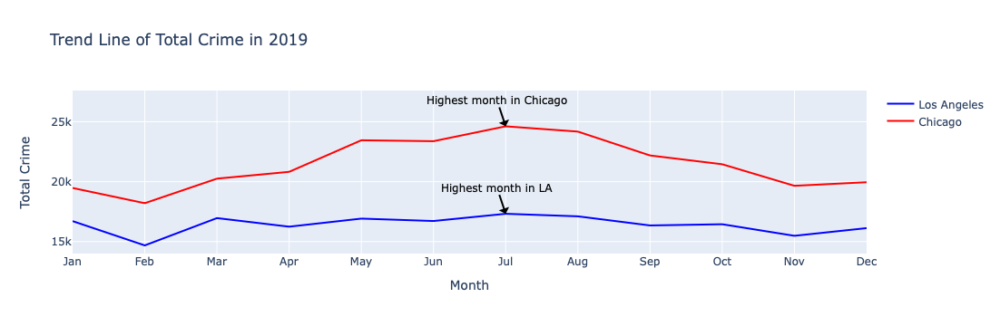

In [49]:
fig = go.Figure()

fig.add_trace(go.Scatter(x=la_monthly['Month'], y=la_monthly['Total Crimes_LA'],
                    mode='lines',
                    name='Los Angeles',
                    line=dict(color='blue'),
                    hovertemplate='Month: %{x}<br>Total Crimes: %{y}'))

fig.add_trace(go.Scatter(x=chi_monthly['Month'], y=chi_monthly['Total Crimes_CHI'],
                    mode='lines',
                    name='Chicago',
                    line=dict(color='red'),
                    hovertemplate='Month: %{x}<br>Total Crimes: %{y}'))

fig.update_layout(title='Trend Line of Total Crime in 2019',
                  xaxis_title='Month',
                  xaxis=dict(type='category', tickmode='array', tickvals=list(range(1, 13)), ticktext=['Jan', 'Feb', 'Mar', 'Apr', 'May', 'Jun', 'Jul', 'Aug', 'Sep', 'Oct', 'Nov', 'Dec']),
                  yaxis_title='Total Crime',
                  yaxis=dict(type='linear'),
                  hovermode='x')

# Adding annotations
# Finding highest month among cities
max_la_month = la_monthly.loc[la_monthly['Total Crimes_LA'].idxmax()]
max_chi_month = chi_monthly.loc[chi_monthly['Total Crimes_CHI'].idxmax()]

fig.add_annotation(
    x=max_la_month['Month'] - 1,
    y=max_la_month['Total Crimes_LA'],
    text='Highest month in LA',
    showarrow=True,
    arrowhead=1,
    arrowsize=1,
    arrowwidth=2,
    arrowcolor="black",
    font=dict(size=12, color="black"),
    align="center"
)

fig.add_annotation(
    x=max_chi_month['Month'] - 1,
    y=max_chi_month['Total Crimes_CHI'],
    text='Highest month in Chicago',
    showarrow=True,
    arrowhead=1,
    arrowsize=1,
    arrowwidth=2,
    arrowcolor="black",
    font=dict(size=12, color="black"),
    align="center"
)

fig.update_layout(showlegend=True)
fig.show()

Important to note here is that LA has a population of 3 million whereas Chicago has 2 million, yet Chicago still has twice the amount of crime. In both cities the highest month of crime in was July. This may be because it is Summer and higher tourism. The lowest month of crime in both cities was February. This may be because school is in session and it's winter.

### Looking into the type of crimes for the lowest and highest months of both cities

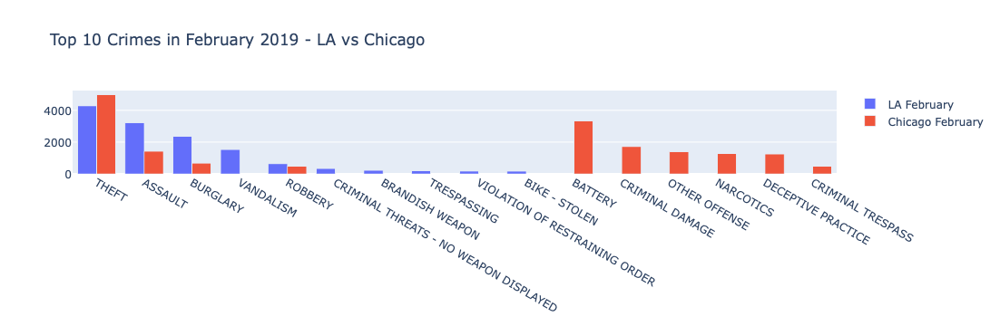

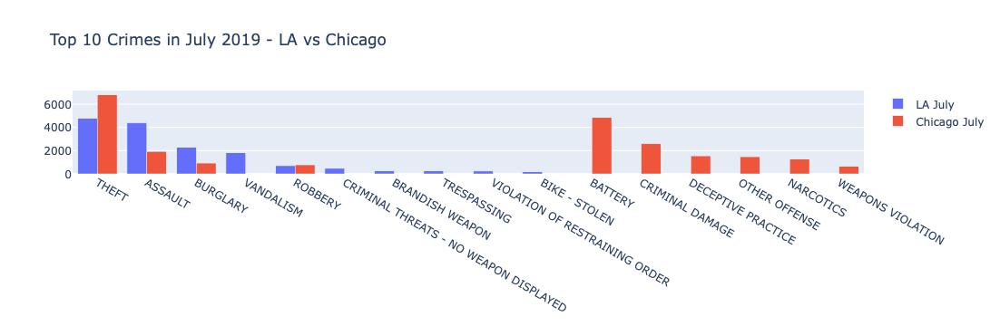

In [50]:
la_feb = df_la1[(df_la1['DATE OCC'].dt.month == 2) & (df_la1['DATE OCC'].dt.year == 2019)]
la_july = df_la1[(df_la1['DATE OCC'].dt.month == 7) & (df_la1['DATE OCC'].dt.year == 2019)]

chi_feb = df_chi[(df_chi['Date'].dt.month == 2) & (df_chi['Date'].dt.year == 2019)]
chi_july = df_chi[(df_chi['Date'].dt.month == 7) & (df_chi['Date'].dt.year == 2019)]

# la changes
la_feb['Crm Cd Desc'] = la_feb['Crm Cd Desc'].replace({'BURGLARY FROM VEHICLE': 'BURGLARY'})
la_july['Crm Cd Desc'] = la_july['Crm Cd Desc'].replace({'BURGLARY FROM VEHICLE': 'BURGLARY'})

la_feb['Crm Cd Desc'] = la_feb['Crm Cd Desc'].apply(lambda x: 'THEFT' if 'THEFT' in x else x)
la_july['Crm Cd Desc'] = la_july['Crm Cd Desc'].apply(lambda x: 'THEFT' if 'THEFT' in x else x)

la_feb['Crm Cd Desc'] = la_feb['Crm Cd Desc'].apply(lambda x: 'VANDALISM' if 'VANDALISM' in x else x)
la_july['Crm Cd Desc'] = la_july['Crm Cd Desc'].apply(lambda x: 'VANDALISM' if 'VANDALISM' in x else x)

la_feb['Crm Cd Desc'] = la_feb['Crm Cd Desc'].apply(lambda x: 'ASSAULT' if 'ASSAULT' in x else x)
la_july['Crm Cd Desc'] = la_july['Crm Cd Desc'].apply(lambda x: 'ASSAULT' if 'ASSAULT' in x else x)

# chicago changes
chi_feb['Primary Type'] = chi_feb['Primary Type'].apply(lambda x: 'THEFT' if 'THEFT' in x else x)
chi_july['Primary Type'] = chi_july['Primary Type'].apply(lambda x: 'THEFT' if 'THEFT' in x else x)

# crime counts
la_feb_crime_counts = la_feb['Crm Cd Desc'].value_counts().head(10)
la_july_crime_counts = la_july['Crm Cd Desc'].value_counts().head(10)

chi_feb_crime_counts = chi_feb['Primary Type'].value_counts().head(10)
chi_july_crime_counts = chi_july['Primary Type'].value_counts().head(10)

#combine code
fig_feb_combined = go.Figure(data=[
    go.Bar(name='LA February', x=la_feb_crime_counts.index, y=la_feb_crime_counts.values),
    go.Bar(name='Chicago February', x=chi_feb_crime_counts.index, y=chi_feb_crime_counts.values)
])

fig_feb_combined.update_layout(barmode='group', title='Top 10 Crimes in February 2019 - LA vs Chicago')
fig_feb_combined.show()

fig_july_combined = go.Figure(data=[
    go.Bar(name='LA July', x=la_july_crime_counts.index, y=la_july_crime_counts.values),
    go.Bar(name='Chicago July', x=chi_july_crime_counts.index, y=chi_july_crime_counts.values)
])

fig_july_combined.update_layout(barmode='group', title='Top 10 Crimes in July 2019 - LA vs Chicago')
fig_july_combined.show()

The top 10 crimes in February 2019 and July 2019 for LA and Chicago share similarities in crimes: theft, assault, burglary, robbery.
However, Chicago still has a lot more violent crimes than LA does, even in February, as some of the more common crimes in LA being stealing bikes and vandalism as opposed to Chicago’s crimes of high battery and criminal damage.

## Visual 5 - Time Series Graph throughout the Years

In [51]:
# los angeles yearly data
#la_years = df_la1[(df_la1['DATE OCC'].dt.year >= 2010) & (df_la1['DATE OCC'].dt.year <= 2019)].copy()
la_years = df_la1

la_years['Year'] = la_years['DATE OCC'].dt.year

la_yearly = la_years.groupby('Year').size().reset_index(name='Total Crimes_LA')


# chicago yearly data
#chi_years = df_chi[(df_chi['Date'].dt.year >= 2010) & (df_chi['Date'].dt.year <= 2019)].copy()
chi_years = df_chi

chi_years['Year'] = chi_years['Date'].dt.year

chi_yearly = chi_years.groupby('Year').size().reset_index(name='Total Crimes_CHI')

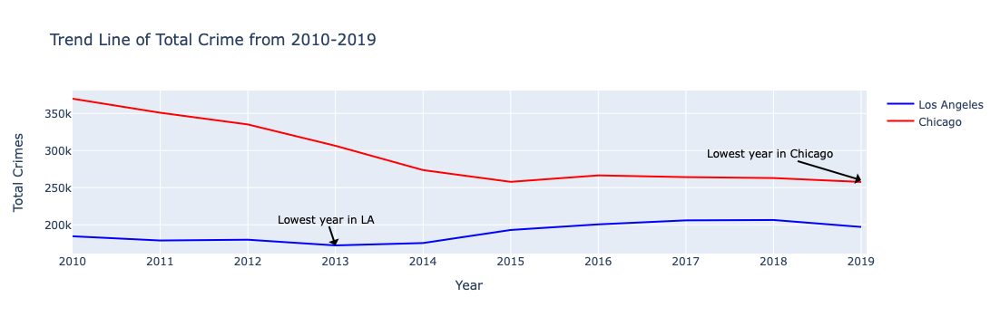

In [52]:
fig = go.Figure()
fig.add_trace(go.Scatter(x=la_yearly['Year'], y=la_yearly['Total Crimes_LA'],
                    mode='lines',
                    name='Los Angeles',
                    line=dict(color='blue'),
                    hovertemplate='Year: %{x}<br>Total Crimes: %{y}'))

fig.add_trace(go.Scatter(x=chi_yearly['Year'], y=chi_yearly['Total Crimes_CHI'],
                    mode='lines',
                    name='Chicago',
                    line=dict(color='red'),
                    hovertemplate='Year: %{x}<br>Total Crimes: %{y}'))

fig.update_layout(title='Trend Line of Total Crime from 2010-2019',
                  xaxis_title='Year',
                  xaxis=dict(type='linear'),
                  yaxis_title='Total Crimes',
                  yaxis=dict(type='linear'),
                  hovermode='x')

# Adding annotations
# Finding lowest year among cities
min_la_year = la_yearly.loc[la_yearly['Total Crimes_LA'].idxmin()]
min_chi_year = chi_yearly.loc[chi_yearly['Total Crimes_CHI'].idxmin()]

fig.add_annotation(
    x=min_la_year['Year'],
    y=min_la_year['Total Crimes_LA'],
    text='Lowest year in LA',
    showarrow=True,
    arrowhead=1,
    arrowsize=1,
    arrowwidth=2,
    arrowcolor="black",
    font=dict(size=12, color="black"),
)

fig.add_annotation(
    x=min_chi_year['Year'],
    y=min_chi_year['Total Crimes_CHI'],
    text='Lowest year in Chicago',
    showarrow=True,
    arrowhead=1,
    arrowsize=1,
    arrowwidth=2,
    arrowcolor="black",
    font=dict(size=12, color="black"),
    ax = -100, 
    yshift = 2
)

fig.update_layout(showlegend=True)
fig.show()

The lowest year for LA was 2013. Crime was decreasing for the 11th year in a row up to 2013 due to intervention and prevention programs, data-driven policing, improved community relations. However, the reason crime “increased” after 2013 was due to incorrect classification of crimes in previous police databases (so for example, certain violent crimes were classified as low-level but are now classified correctly), so when they fixed this system, the data showed an increase in crime.

The lowest year for Chicago was 2019. More arrests were being made, removal and recovery of illegal firearms, drop in gun violence led to less robberies and burglary and shootings, domino effect, more funding toward violence reduction and programs, youth-focused interventions, all whichlessened crime.